# GeoVisualization


In [76]:
import pandas


In [77]:
df = pandas.read_csv("./data/shared/covid/covid_combined.csv", index_col="date",
                    parse_dates=True)

In [78]:
df.head()

,state,fips,cases,deaths,dtc100,population,deaths100k
date,,,,,,,
2020-01-21,Washington,53,1,0,0.0,7614893,0.0
2020-01-22,Washington,53,1,0,0.0,7614893,0.0
2020-01-23,Washington,53,1,0,0.0,7614893,0.0
2020-01-24,Washington,53,1,0,0.0,7614893,0.0
2020-01-25,Washington,53,1,0,0.0,7614893,0.0


In [79]:
last_df = df.loc['2020-08-02']

In [80]:
last_df.shape

(54, 7)

In [81]:
import geopandas

In [82]:
gdf = geopandas.read_file("./data/shared/covid/gz_2010_us_040_00_500k.json")

In [83]:
gdf.head()

,GEO_ID,STATE,NAME,LSAD,CENSUSAREA,geometry
0,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ..."
1,0400000US25,25,Massachusetts,,7800.058,"MULTIPOLYGON (((-70.83204 41.60650, -70.82373 ..."
2,0400000US26,26,Michigan,,56538.901,"MULTIPOLYGON (((-88.68443 48.11579, -88.67563 ..."
3,0400000US30,30,Montana,,145545.801,"POLYGON ((-104.05770 44.99743, -104.25015 44.9..."
4,0400000US32,32,Nevada,,109781.180,"POLYGON ((-114.05060 37.00040, -114.04999 36.9..."


In [84]:
gdf.columns.values

array(['GEO_ID', 'STATE', 'NAME', 'LSAD', 'CENSUSAREA', 'geometry'],
      dtype=object)

<AxesSubplot:>

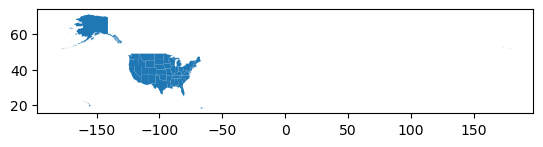

In [85]:
gdf.plot()

In [86]:
df.head()

,state,fips,cases,deaths,dtc100,population,deaths100k
date,,,,,,,
2020-01-21,Washington,53,1,0,0.0,7614893,0.0
2020-01-22,Washington,53,1,0,0.0,7614893,0.0
2020-01-23,Washington,53,1,0,0.0,7614893,0.0
2020-01-24,Washington,53,1,0,0.0,7614893,0.0
2020-01-25,Washington,53,1,0,0.0,7614893,0.0


## Table Join

In [87]:
gdf.rename(columns={'NAME': 'state'}, inplace=True)
gdf.head()

,GEO_ID,STATE,state,LSAD,CENSUSAREA,geometry
0,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ..."
1,0400000US25,25,Massachusetts,,7800.058,"MULTIPOLYGON (((-70.83204 41.60650, -70.82373 ..."
2,0400000US26,26,Michigan,,56538.901,"MULTIPOLYGON (((-88.68443 48.11579, -88.67563 ..."
3,0400000US30,30,Montana,,145545.801,"POLYGON ((-104.05770 44.99743, -104.25015 44.9..."
4,0400000US32,32,Nevada,,109781.180,"POLYGON ((-114.05060 37.00040, -114.04999 36.9..."


In [88]:
df['date'] = df.index.values
join_gdf = gdf.merge(df, on='state')
join_gdf.head()

,GEO_ID,STATE,state,LSAD,CENSUSAREA,geometry,fips,cases,deaths,dtc100,population,deaths100k,date
0,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,1,0,0.0,1344212,0.0,2020-03-12
1,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,2,0,0.0,1344212,0.0,2020-03-13
2,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,3,0,0.0,1344212,0.0,2020-03-14
3,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,12,0,0.0,1344212,0.0,2020-03-15
4,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,17,0,0.0,1344212,0.0,2020-03-16


In [89]:
last_gdf = join_gdf[join_gdf.date=='2020-08-02']
last_gdf.shape

(52, 13)

In [90]:
drop = ['Puerto Rico', 'Alaska', 'Hawaii']
last_gdf = last_gdf[~last_gdf['state'].isin(drop)]

In [91]:
last_gdf.shape

(49, 13)

<AxesSubplot:>

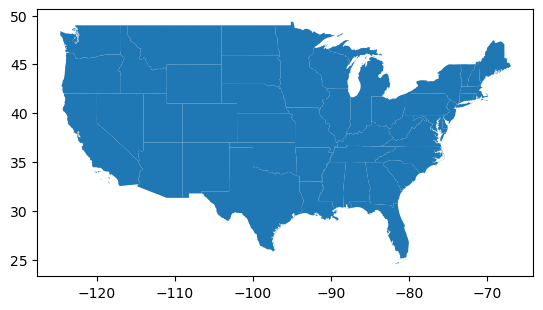

In [92]:
last_gdf.plot()

<AxesSubplot:>

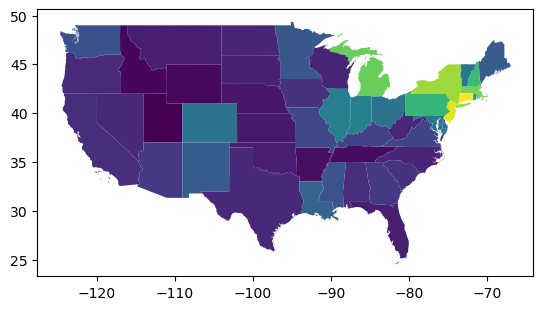

In [16]:
last_gdf.plot(column='dtc100')

<AxesSubplot:>

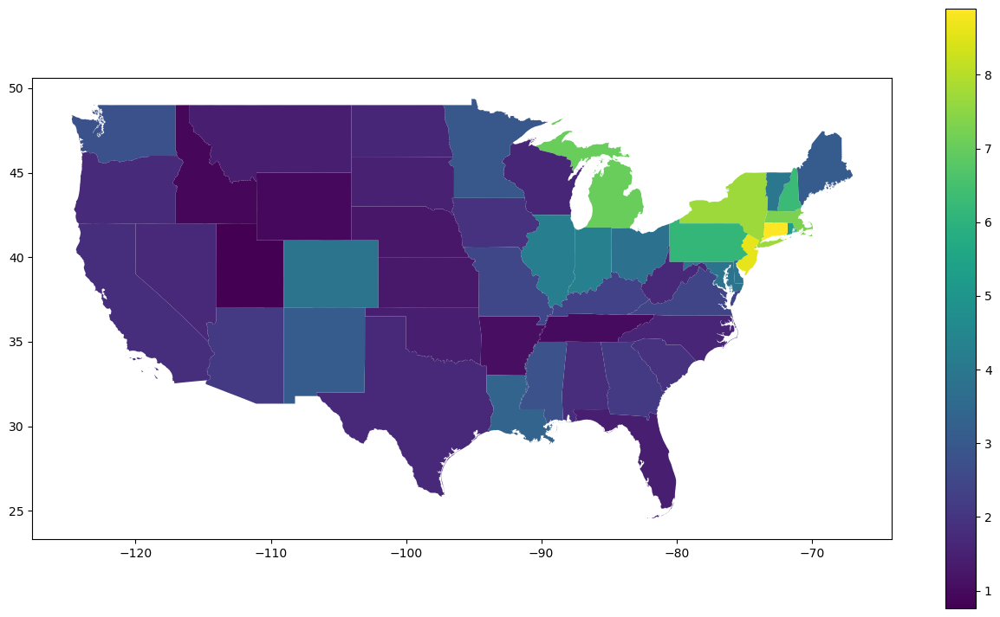

In [93]:
last_gdf.plot(column='dtc100', legend=True, figsize=(16,9))


<AxesSubplot:>

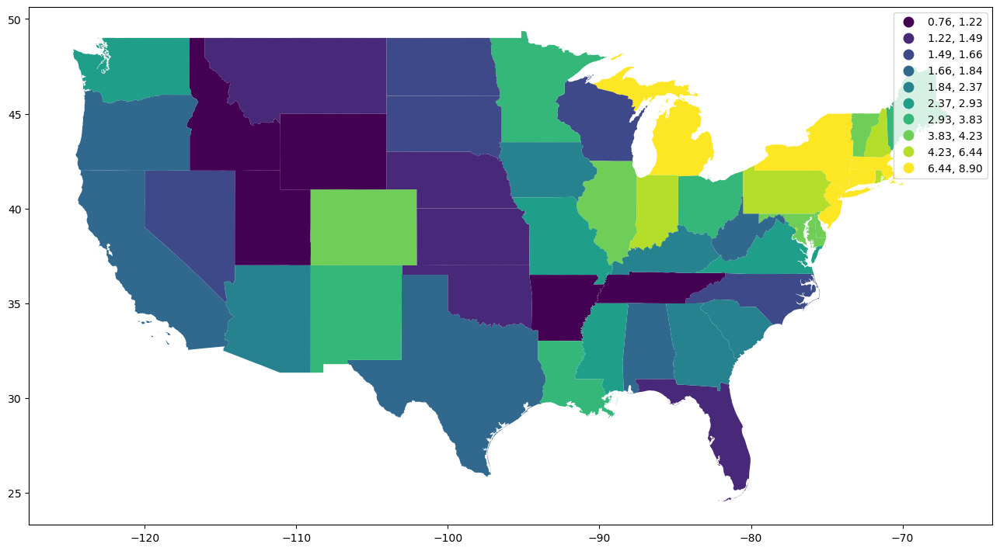

In [94]:
last_gdf.plot(column='dtc100', legend=True, figsize=(16,9),
               scheme='quantiles', k=10)

<AxesSubplot:>

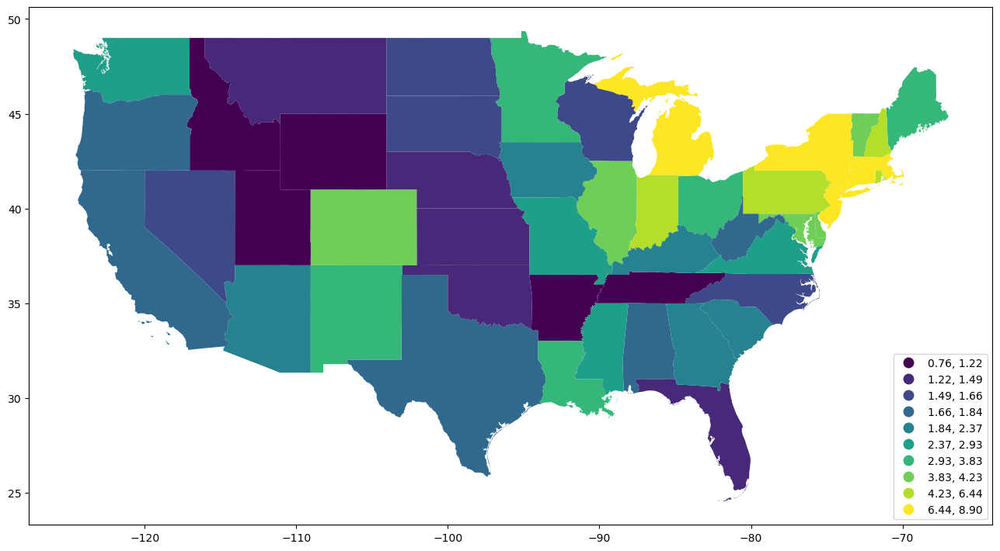

In [95]:
last_gdf.plot(column='dtc100', legend=True, figsize=(16,9),
               scheme='quantiles', k=10,
               legend_kwds={'loc': 'lower right'})

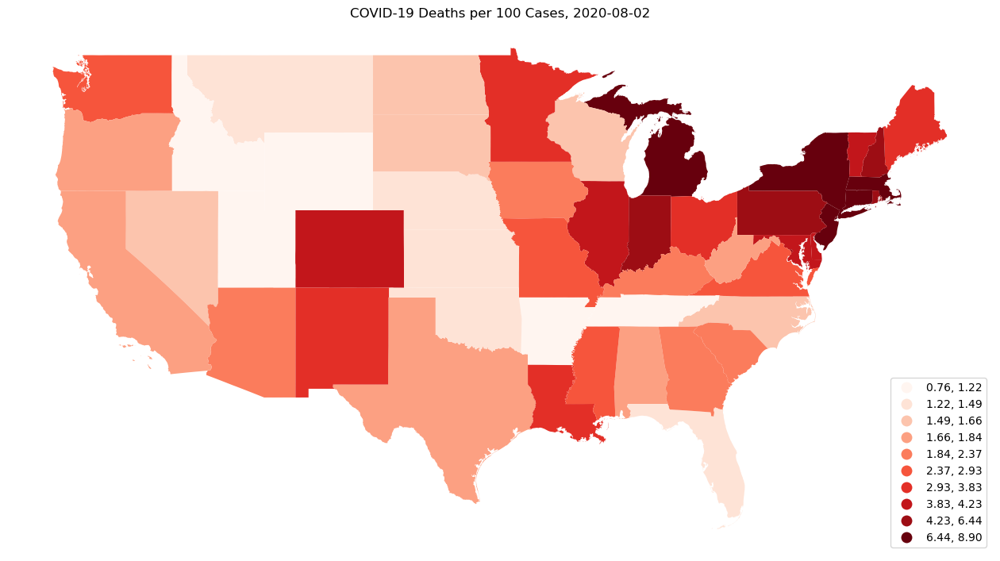

In [96]:
ax = last_gdf.plot(column='dtc100', scheme='quantiles',k=10, legend=True,
             figsize=(16,9), cmap='Reds',
             legend_kwds={'loc': 'lower right'})
ax.set_title('COVID-19 Deaths per 100 Cases, 2020-08-02')
ax.set_axis_off()


## Classifiers


### Equal Interval

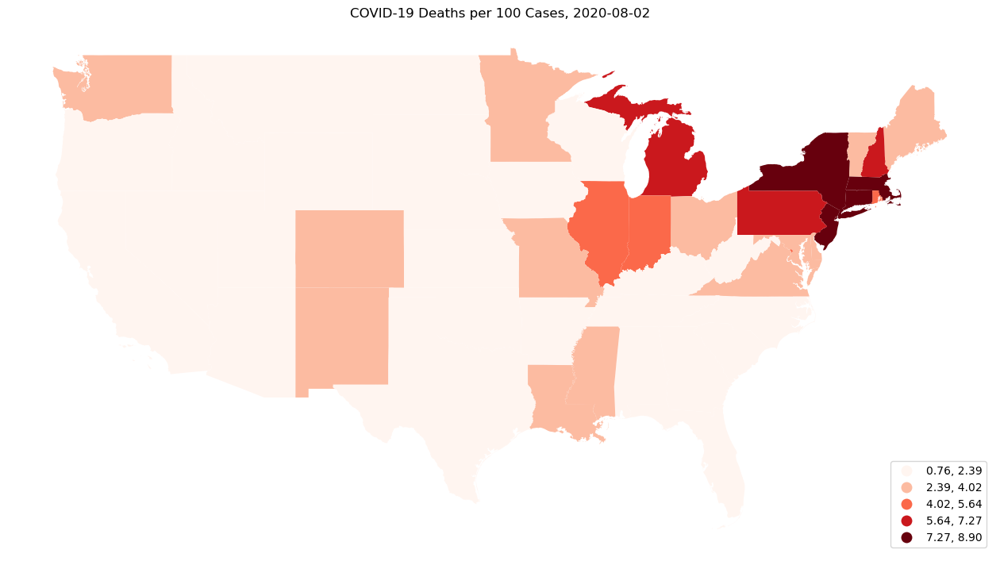

In [97]:
ax = last_gdf.plot(column='dtc100', scheme='EqualInterval',k=5, legend=True,
             figsize=(16,9), cmap='Reds',
             legend_kwds={'loc': 'lower right'})
ax.set_title('COVID-19 Deaths per 100 Cases, 2020-08-02')
ax.set_axis_off()


In [98]:
y = last_gdf.dtc100
import mapclassify

In [99]:
ea5 = mapclassify.EqualInterval(y, k=5)

In [100]:
ea5

EqualInterval

  Interval     Count
--------------------
[0.76, 2.39] |    25
(2.39, 4.02] |    13
(4.02, 5.64] |     4
(5.64, 7.27] |     3
(7.27, 8.90] |     4

In [101]:
4.02-2.39

1.6299999999999994

In [102]:
5.64-4.02

1.62

### Equal Count (Quantiles)

In [103]:
eq5 = mapclassify.Quantiles(y, k=5)

In [104]:
eq5

Quantiles

  Interval     Count
--------------------
[0.76, 1.49] |    10
(1.49, 1.84] |    10
(1.84, 2.93] |     9
(2.93, 4.23] |    10
(4.23, 8.90] |    10

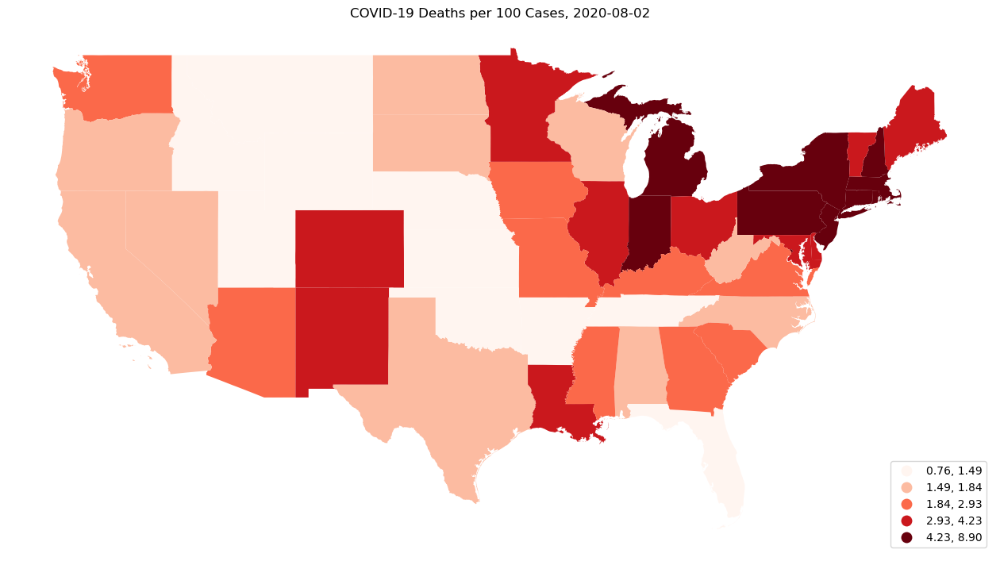

In [105]:
ax = last_gdf.plot(column='dtc100', scheme='Quantiles',k=5, legend=True,
             figsize=(16,9), cmap='Reds',
             legend_kwds={'loc': 'lower right'})
ax.set_title('COVID-19 Deaths per 100 Cases, 2020-08-02')
ax.set_axis_off()


### Maximum Breaks

In [106]:
mb5 = mapclassify.MaximumBreaks(y, k=5)
mb5

MaximumBreaks

  Interval     Count
--------------------
[0.76, 5.03] |    41
(5.03, 5.73] |     1
(5.73, 6.66] |     2
(6.66, 8.15] |     3
(8.15, 8.90] |     2

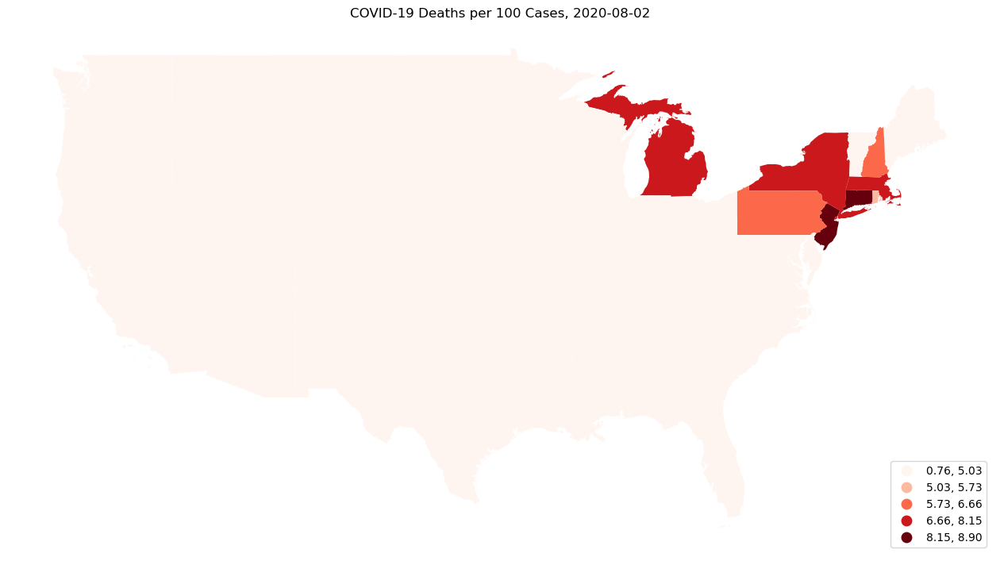

In [107]:
ax = last_gdf.plot(column='dtc100', scheme='MaximumBreaks',k=5, legend=True,
             figsize=(16,9), cmap='Reds',
             legend_kwds={'loc': 'lower right'})
ax.set_title('COVID-19 Deaths per 100 Cases, 2020-08-02')
ax.set_axis_off()


### Box Plot

In [108]:
mapclassify.BoxPlot(y)

BoxPlot

   Interval      Count
----------------------
( -inf, -1.82] |     0
(-1.82,  1.62] |    13
( 1.62,  2.37] |    12
( 2.37,  3.91] |    12
( 3.91,  7.35] |     9
( 7.35,  8.90] |     3

In [109]:
y.median()

2.3743977976600137

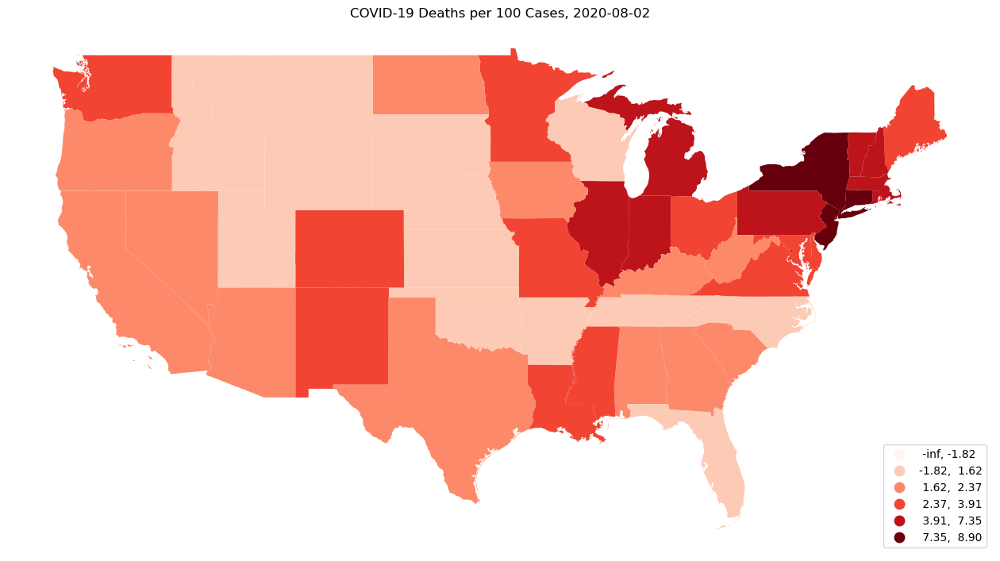

In [110]:
ax = last_gdf.plot(column='dtc100', scheme='BoxPlot', legend=True,
             figsize=(16,9), cmap='Reds',
             legend_kwds={'loc': 'lower right'})
ax.set_title('COVID-19 Deaths per 100 Cases, 2020-08-02')
ax.set_axis_off()


In [35]:
mapclassify.BoxPlot?

Init signature: mapclassify.BoxPlot(y, hinge=1.5)
Docstring:     
BoxPlot Map Classification.

Parameters
----------

y : numpy.array
    Attribute to classify
hinge : float (default 1.5)
    Multiplier for *IQR*.

Attributes
----------

yb : numpy.array
    :math:`(n,1)`, bin ids for observations.
bins : array
    :math:`(n,1)`, the upper bounds of each class  (monotonic).
k : int
    The number of classes.
counts : numpy.array
    :math:`(k,1)`, the number of observations falling in each class.
low_outlier_ids : numpy.array
    Indices of observations that are low outliers.
high_outlier_ids : numpy.array
    Indices of observations that are high outliers.

Notes
-----

The bins are set as follows::

    bins[0] = q[0]-hinge*IQR
    bins[1] = q[0]
    bins[2] = q[1]
    bins[3] = q[2]
    bins[4] = q[2]+hinge*IQR
    bins[5] = inf  (see Notes)

where :math:`q` is an array of the first three quartiles of :math:`y` and
:math:`IQR=q[2]-q[0]`.

If :math:`q[2]+hinge*IQR > max(y)` there wil

### STDMEAN

In [111]:
mapclassify.StdMean(y)

StdMean

   Interval      Count
----------------------
( -inf, -1.15] |     0
(-1.15,  0.97] |     3
( 0.97,  5.22] |    38
( 5.22,  7.34] |     5
( 7.34,  8.90] |     3

In [112]:
y.mean()- y.std()

0.9741967014843262

In [113]:
y.mean()+y.std()

5.217609367021282

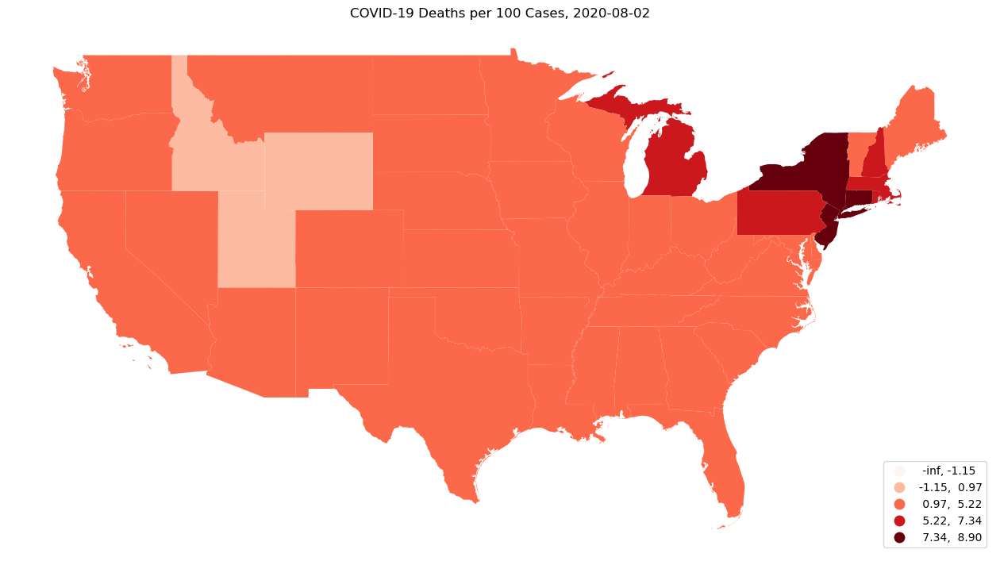

In [114]:
ax = last_gdf.plot(column='dtc100', scheme='StdMean', legend=True,
             figsize=(16,9), cmap='Reds',
             legend_kwds={'loc': 'lower right'})
ax.set_title('COVID-19 Deaths per 100 Cases, 2020-08-02')
ax.set_axis_off()


### Fisher-Jenks

In [115]:
mapclassify.FisherJenks(y, k=5)

FisherJenks

  Interval     Count
--------------------
[0.76, 2.12] |    24
(2.12, 3.34] |     9
(3.34, 5.29] |     9
(5.29, 7.29] |     4
(7.29, 8.90] |     3

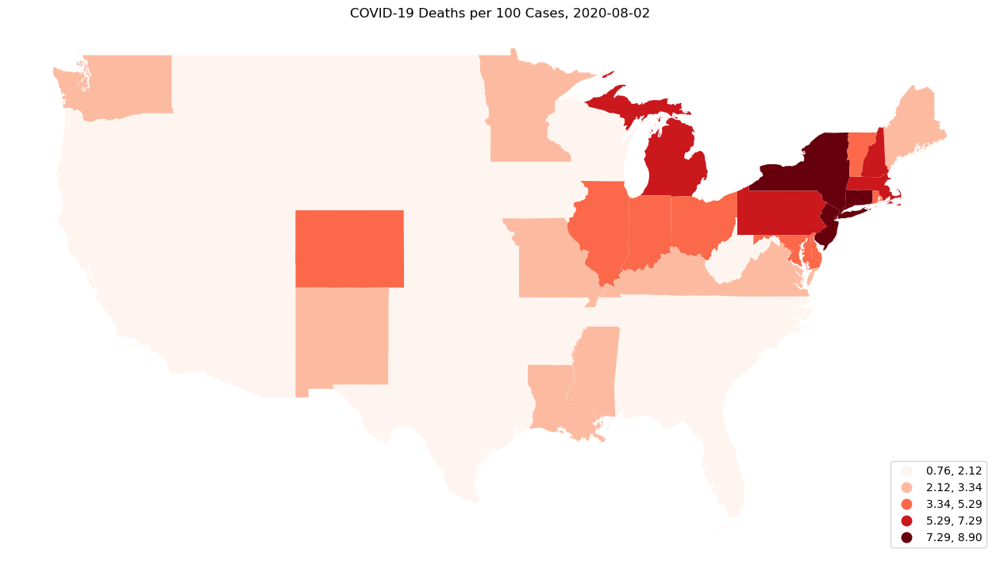

In [116]:
ax = last_gdf.plot(column='dtc100', scheme='FisherJenks', k=5, legend=True,
             figsize=(16,9), cmap='Reds',
             legend_kwds={'loc': 'lower right'})
ax.set_title('COVID-19 Deaths per 100 Cases, 2020-08-02')
ax.set_axis_off()


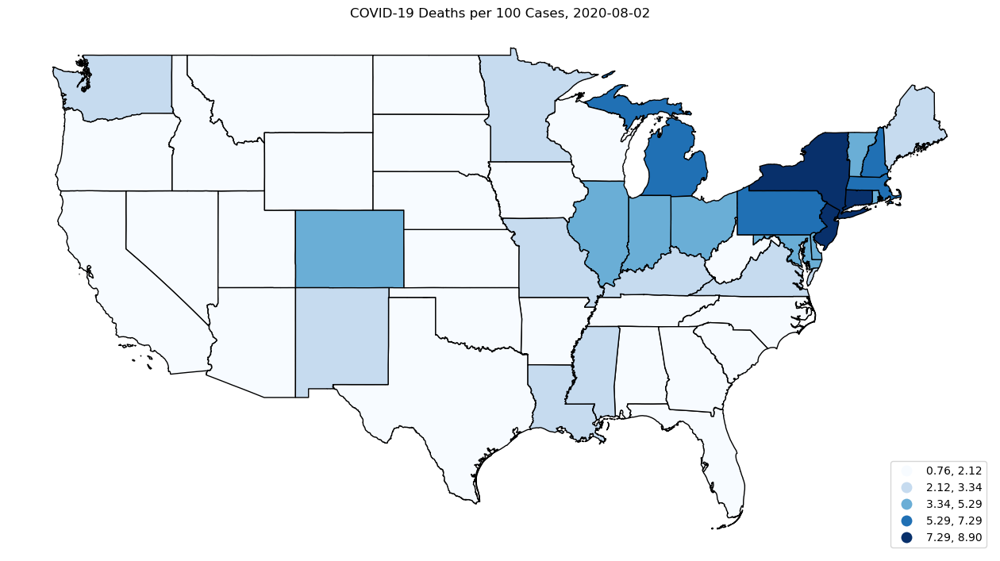

In [121]:
ax = last_gdf.plot(column='dtc100', scheme='FisherJenks', k=5, legend=True,
             figsize=(16,9), cmap='Blues',edgecolor='k',
             legend_kwds={'loc': 'lower right'})
ax.set_title('COVID-19 Deaths per 100 Cases, 2020-08-02')
ax.set_axis_off()


In [120]:
fj5 = mapclassify.FisherJenks(y,5)
q5 = mapclassify.Quantiles(y, 5)
ea5 = mapclassify.EqualInterval(y, 5)
fj5.adcm, q5.adcm, ea5.adcm

(15.68079626959761, 21.603825374669483, 18.970554166382374)

## Color: Categorical 

In [44]:
c_gdf = last_gdf.to_crs(last_gdf.estimate_utm_crs())

In [122]:
centroids =c_gdf.centroid

In [123]:
east = c_gdf.centroid.x > c_gdf.centroid.x.median()
north = c_gdf.centroid.y > c_gdf.centroid.y.median()

In [124]:
c_gdf['east'] = c_gdf.centroid.x < centroids.x.median()
c_gdf['west'] = c_gdf.centroid.x >= centroids.x.median()
c_gdf['south'] = c_gdf.centroid.y < centroids.y.median()
c_gdf['north'] = c_gdf.centroid.y >= centroids.y.median()
c_gdf['NE'] = c_gdf.north * c_gdf.east
c_gdf['SE'] = c_gdf.south * c_gdf.east
c_gdf['NW'] = c_gdf.north * c_gdf.west
c_gdf['SW'] = c_gdf.south * c_gdf.west
    



c_gdf['region'] = (1 * c_gdf.NE) + (2 * c_gdf.NW) + (3* c_gdf.SW) + (4*c_gdf.SE)


In [125]:
c_gdf.groupby(by='region').count()

,GEO_ID,STATE,state,LSAD,CENSUSAREA,geometry,fips,cases,deaths,dtc100,...,date,east,west,south,north,NE,SE,NW,SW,usgreedy
region,,,,,,,,,,,,,,,,,,,,,
1,14,14,14,14,14,14,14,14,14,14,...,14,14,14,14,14,14,14,14,14,14
2,11,11,11,11,11,11,11,11,11,11,...,11,11,11,11,11,11,11,11,11,11
3,14,14,14,14,14,14,14,14,14,14,...,14,14,14,14,14,14,14,14,14,14
4,10,10,10,10,10,10,10,10,10,10,...,10,10,10,10,10,10,10,10,10,10


<AxesSubplot:>

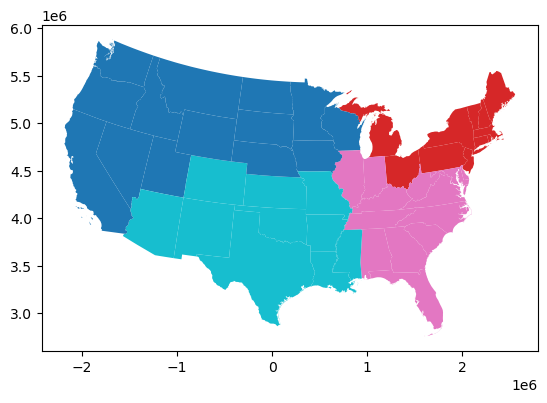

In [126]:
c_gdf.plot(column='region', categorical=True)

<AxesSubplot:>

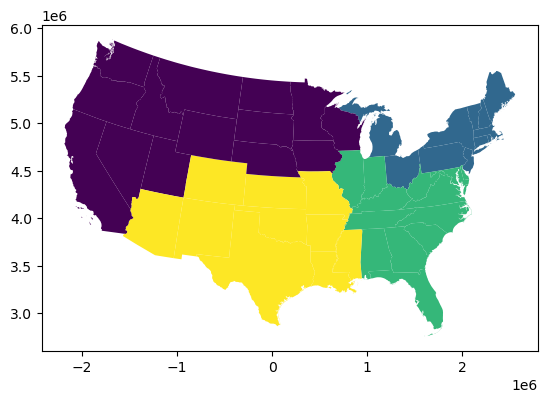

In [127]:
c_gdf.plot(column='region')

In [128]:

usgreedy = mapclassify.greedy(c_gdf)

<AxesSubplot:>

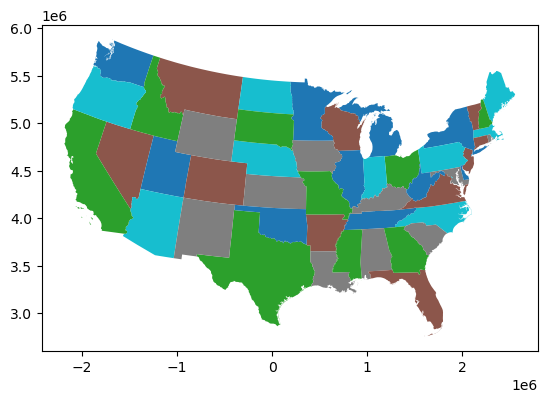

In [51]:
c_gdf['usgreedy'] = usgreedy
c_gdf.plot(column='usgreedy', categorical=True)

## Spatial Dynamics

In [129]:

join_gdf.head()

,GEO_ID,STATE,state,LSAD,CENSUSAREA,geometry,fips,cases,deaths,dtc100,population,deaths100k,date
0,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,1,0,0.0,1344212,0.0,2020-03-12
1,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,2,0,0.0,1344212,0.0,2020-03-13
2,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,3,0,0.0,1344212,0.0,2020-03-14
3,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,12,0,0.0,1344212,0.0,2020-03-15
4,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,17,0,0.0,1344212,0.0,2020-03-16


In [130]:
dates = [f"2020-{month:02}-01"  for month  in range(5,9)]

dates

['2020-05-01', '2020-06-01', '2020-07-01', '2020-08-01']

In [131]:
last4 = join_gdf[join_gdf.date.isin(dates)]
last4 = last4[~last4['state'].isin(drop)]
last4.shape

(196, 13)

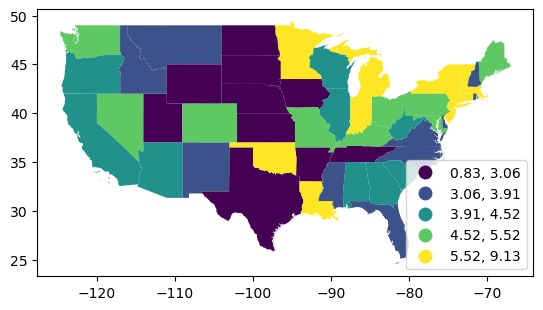

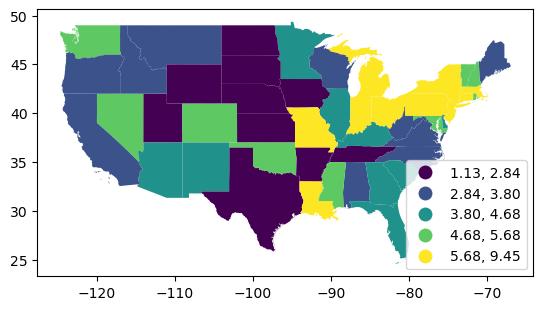

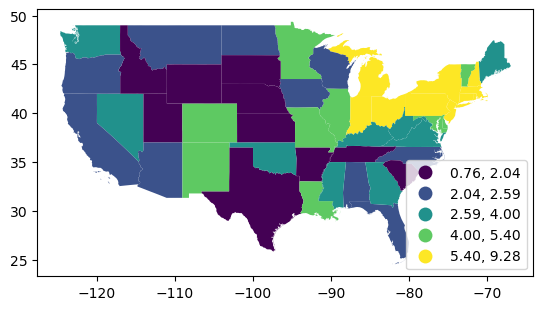

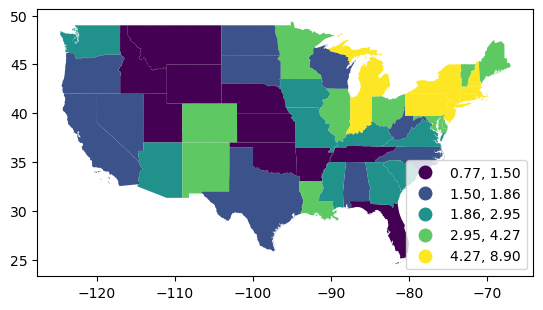

In [55]:
for day in dates:
    last4[last4.date==day].plot(column='dtc100', scheme='Quantiles', k=5, 
                                legend=True, legend_kwds={'loc': 'lower right'})

In [132]:
import mapclassify

q5 = mapclassify.Quantiles(last4.dtc100, k=5)

q5

Quantiles

  Interval     Count
--------------------
[0.76, 1.87] |    40
(1.87, 3.12] |    39
(3.12, 4.20] |    39
(4.20, 5.44] |    39
(5.44, 9.45] |    39

In [57]:
q5.bins

array([1.86813187, 3.12420625, 4.20334682, 5.44027239, 9.45494994])

In [133]:
last4['pooled5'] = q5.yb

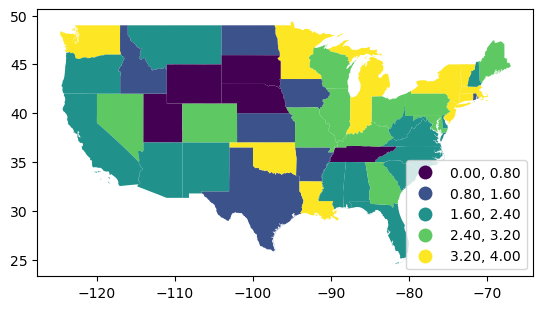

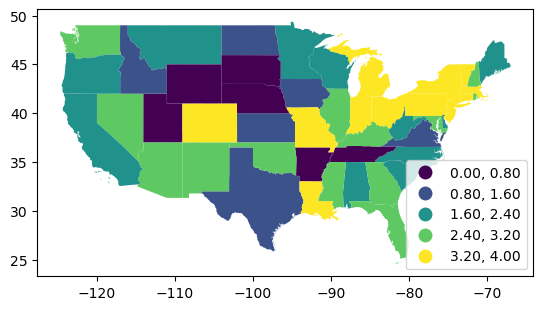

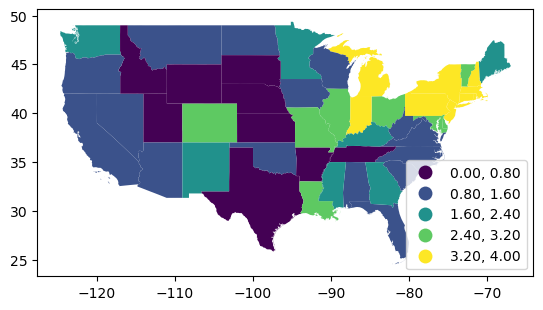

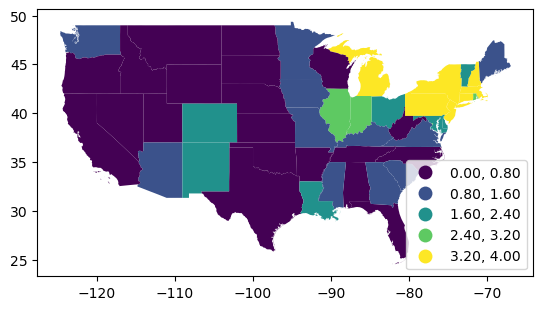

In [135]:
for day in dates:
    last4[last4.date==day].plot(column='pooled5', scheme='equalinterval',
                                legend=True, legend_kwds={'loc': 'lower right'})

## Interactive Maps



In [136]:
last_gdf.columns

Index(['GEO_ID', 'STATE', 'state', 'LSAD', 'CENSUSAREA', 'geometry', 'fips',
       'cases', 'deaths', 'dtc100', 'population', 'deaths100k', 'date'],
      dtype='object')

In [138]:
last_gdf = last_gdf[['GEO_ID', 'STATE', 'state', 'LSAD', 'CENSUSAREA', 'geometry', 'fips',
       'cases', 'deaths', 'dtc100', 'population', 'deaths100k']] # omit the date column

In [139]:
last_gdf.explore()

In [140]:
last_gdf.explore(column='dtc100')

In [143]:
last_gdf.explore(column='dtc100', scheme='quantiles', k=5)

In [65]:
last_gdf.head()

,GEO_ID,STATE,state,LSAD,CENSUSAREA,geometry,fips,cases,deaths,dtc100,population,deaths100k
143,0400000US23,23,Maine,,30842.923,"MULTIPOLYGON (((-67.61976 44.51975, -67.61541 ...",23,3958,123,3.107630,1344212,9.150342
327,0400000US25,25,Massachusetts,,7800.058,"MULTIPOLYGON (((-70.83204 41.60650, -70.82373 ...",25,118458,8638,7.292036,6949503,124.296658
473,0400000US26,26,Michigan,,56538.901,"MULTIPOLYGON (((-88.68443 48.11579, -88.67563 ...",26,91857,6460,7.032670,9986857,64.685016
616,0400000US30,30,Montana,,145545.801,"POLYGON ((-104.05770 44.99743, -104.25015 44.9...",30,4193,61,1.454806,1068778,5.707453
767,0400000US32,32,Nevada,,109781.180,"POLYGON ((-114.05060 37.00040, -114.04999 36.9...",32,50270,833,1.657052,3080156,27.044085


In [144]:
last_gdf.explore(column='dtc100', scheme='quantiles', k=5,
                tooltip=['dtc100', 'state', 'fips'])

In [145]:
import folium

In [146]:
centroids = last_gdf.centroid

/tmp/ipykernel_3348826/2951951418.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = last_gdf.centroid


In [147]:
m = last_gdf.explore(column='dtc100', scheme='quantiles', k=5,
                tooltip=['dtc100', 'state', 'fips'])
centroids.explore(m=m)
m

In [148]:
m = last_gdf.explore(column='dtc100', scheme='quantiles', k=5,
                tooltip=['dtc100', 'state', 'fips'],
                    name='polygon')
centroids.explore(m=m, name='centroid')
folium.LayerControl().add_to(m)
m

In [149]:
m = last_gdf.explore(column='dtc100', scheme='quantiles', k=5,
                tooltip=['dtc100', 'state', 'fips'],
                    name='polygon', tiles='Stamen Toner')
centroids.explore(m=m, name='centroid')
folium.LayerControl().add_to(m)
m

In [150]:
m = last_gdf.explore(column='dtc100', scheme='quantiles', k=5,
                tooltip=['dtc100', 'state', 'fips'],
                    name='polygon', tiles='Stamen Terrain')
centroids.explore(m=m, name='centroid')
folium.LayerControl().add_to(m)
m

In [151]:
m = last_gdf.explore(column='dtc100', scheme='quantiles', k=5,
                tooltip=['dtc100', 'state', 'fips'],
                    name='polygon', tiles='CartoDB positron')
centroids.explore(m=m, name='centroid')
folium.LayerControl().add_to(m)
m

In [74]:
m.crs

'EPSG3857'

In [153]:
m = last_gdf.explore(column='dtc100', scheme='quantiles', k=5,
                tooltip=['dtc100', 'state', 'fips'],
                    name='polygon', tiles='CartoDB positron')
centroids.explore(m=m, name='centroid')
folium.Marker([32.7774, -117.0714],
              popup='SDSU',
              icon=folium.Icon(color='red', icon='ok-sign'),).add_to(m)
folium.LayerControl().add_to(m)
m